##IMPORTING LIBRARIES

In [ ]:
!pip install -q ultralytics
!pip install lap
import os
import cv2
import numpy as np
from collections import defaultdict
from IPython.display import display, Image, Video
from google.colab import files
from ultralytics import YOLO

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 17.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 96.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 76.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 45.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 3.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 6.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 11.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 59.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.7/1.7 MB 17.0 MB/s eta 0:00:00
Creating new Ultralytics Settings v0.0.6 file ✅ 


 **RUN THE BELOW CODE SNIPPET TO DOWNLOAD THE DATASET**

In [ ]:
%%bash
cd /content
mkdir -p dataset3
cd dataset3
curl -L "https://universe.roboflow.com/ds/2iDgDUKL5w?key=Qt1UfrmPN7" -o roboflow.zip
unzip -q roboflow.zip
rm roboflow.zip

**SICK CHICKEN DETECTION WITH BBOX FROM VIDEO**

In [ ]:
import os
import cv2
import numpy as np
from collections import defaultdict
from IPython.display import display, Image
from google.colab import files
from ultralytics import YOLO

# Upload media
uploaded = files.upload()
file_path = next(iter(uploaded))
is_video = file_path.lower().endswith(('.mp4', '.avi', '.mov'))

# Directories
output_dir = "/content/results"
os.makedirs(output_dir, exist_ok=True)

# Load model
model = YOLO("/content/best (3)_sayan.pt")  # Your model with healthy/sick classification
class_names = model.names
detection_confidence = 0.2

# Get unique color for each ID
def get_color(idx):
    np.random.seed(idx)
    return tuple(int(c) for c in np.random.randint(0, 255, size=3))

# Draw trails
trails = defaultdict(list)

# ----------- IMAGE MODE -----------
if not is_video:
    results = model(file_path, conf=detection_confidence)[0]
    im = results.orig_img.copy()

    for i, box in enumerate(results.boxes):
        conf = float(box.conf[0])
        if conf < detection_confidence:
            continue

        x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
        cls_id = int(box.cls[0])
        class_name = class_names[cls_id]

        # Only show boxes for sick chickens
        if class_name.lower() == "sick":
            label = f"{class_name} ({conf:.2f})"
            cv2.rectangle(im, (x1, y1), (x2, y2), (0, 0, 255), 2)
            cv2.putText(im, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255), 2)

    output_img_path = os.path.join(output_dir, "sick_chickens.jpg")
    cv2.imwrite(output_img_path, im)
    display(Image(filename=output_img_path))

# ----------- VIDEO MODE -----------
else:
    cap = cv2.VideoCapture(file_path)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = cap.get(cv2.CAP_PROP_FPS)
    out_path = os.path.join(output_dir, "sick_chickens_video.mp4")
    out = cv2.VideoWriter(out_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (width, height))

    for results in model.track(source=file_path, persist=True, stream=True, conf=detection_confidence, tracker="bytetrack.yaml"):
        frame = results.orig_img.copy()
        boxes = results.boxes

        if boxes.id is not None:
            for box, track_id in zip(boxes, boxes.id):
                conf = float(box.conf[0])
                if conf < detection_confidence:
                    continue

                x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
                cls_id = int(box.cls[0])
                class_name = class_names[cls_id]

                if class_name.lower() == "sick":
                    track_id = int(track_id)
                    label = f"{class_name} - ID {track_id} ({conf:.2f})"
                    color = get_color(track_id)

                    cv2.rectangle(frame, (x1, y1), (x2, y2), color, 2)
                    cv2.putText(frame, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

                    # Optional: Draw trails
                    center = (int((x1 + x2) / 2), int((y1 + y2) / 2))
                    trails[track_id].append(center)
                    if len(trails[track_id]) > 30:
                        trails[track_id].pop(0)
                    for j in range(1, len(trails[track_id])):
                        cv2.line(frame, trails[track_id][j - 1], trails[track_id][j], color, 2)

        out.write(frame)

    cap.release()
    out.release()
    display(Video(out_path, embed=True))

Saving WhatsApp Video 2025-06-04 at 23.07.37_604d650e.mp4 to WhatsApp Video 2025-06-04 at 23.07.37_604d650e (1).mp4

video 1/1 (frame 1/804) /content/WhatsApp Video 2025-06-04 at 23.07.37_604d650e (1).mp4: 352x640 3 Healthys, 372.0ms
video 1/1 (frame 2/804) /content/WhatsApp Video 2025-06-04 at 23.07.37_604d650e (1).mp4: 352x640 3 Healthys, 142.3ms
video 1/1 (frame 3/804) /content/WhatsApp Video 2025-06-04 at 23.07.37_604d650e (1).mp4: 352x640 3 Healthys, 139.6ms
video 1/1 (frame 4/804) /content/WhatsApp Video 2025-06-04 at 23.07.37_604d650e (1).mp4: 352x640 3 Healthys, 122.1ms
video 1/1 (frame 5/804) /content/WhatsApp Video 2025-06-04 at 23.07.37_604d650e (1).mp4: 352x640 3 Healthys, 125.1ms
video 1/1 (frame 6/804) /content/WhatsApp Video 2025-06-04 at 23.07.37_604d650e (1).mp4: 352x640 3 Healthys, 146.0ms
video 1/1 (frame 7/804) /content/WhatsApp Video 2025-06-04 at 23.07.37_604d650e (1).mp4: 352x640 3 Healthys, 139.2ms
video 1/1 (frame 8/804) /content/WhatsApp Video 2025-06-04 at 23

In [ ]:
import os
import cv2
import numpy as np
from collections import defaultdict
from IPython.display import display, Image, Video
from google.colab import files
from ultralytics import YOLO

# Upload media
uploaded = files.upload()
file_path = next(iter(uploaded))
is_video = file_path.lower().endswith(('.mp4', '.avi', '.mov'))

# Directories
output_dir = "/content/results"
os.makedirs(output_dir, exist_ok=True)

# Load model
model = YOLO("/content/best (3)_sayan.pt")  # Path to your YOLOv8 model
class_names = model.names
detection_confidence = 0.2

# Get unique color for each ID
def get_color(idx):
    np.random.seed(idx)
    return tuple(int(c) for c in np.random.randint(0, 255, size=3))

# IoU for ID matching
def iou(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])
    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)
    boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
    boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)
    return interArea / float(boxAArea + boxBArea - interArea + 1e-6)

# Draw trails
trails = defaultdict(list)
persistent_id_map = {}  # tracker_id -> persistent_id
last_boxes = {}         # persistent_id -> last known box
next_id = 0             # Counter for assigning new persistent IDs

# ----------- IMAGE MODE -----------
if not is_video:
    results = model(file_path, conf=detection_confidence)[0]
    im = results.orig_img.copy()

    for i, box in enumerate(results.boxes):
        conf = float(box.conf[0])
        if conf < detection_confidence:
            continue

        x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
        cls_id = int(box.cls[0])
        class_name = class_names[cls_id]

        if class_name.lower() == "sick":
            label = f"{class_name} ({conf:.2f})"
            cv2.rectangle(im, (x1, y1), (x2, y2), (0, 0, 255), 2)
            cv2.putText(im, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255), 2)

    output_img_path = os.path.join(output_dir, "sick_chickens.jpg")
    cv2.imwrite(output_img_path, im)
    display(Image(filename=output_img_path))

# ----------- VIDEO MODE -----------
else:
    cap = cv2.VideoCapture(file_path)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = cap.get(cv2.CAP_PROP_FPS)
    out_path = os.path.join(output_dir, "sick_chickens_video.mp4")
    out = cv2.VideoWriter(out_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (width, height))

    for results in model.track(source=file_path, persist=True, stream=True, conf=detection_confidence, tracker="bytetrack.yaml"):
        frame = results.orig_img.copy()
        boxes = results.boxes

        if boxes.id is not None:
            for box, tracker_id in zip(boxes, boxes.id):
                conf = float(box.conf[0])
                if conf < detection_confidence:
                    continue

                x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
                cls_id = int(box.cls[0])
                class_name = class_names[cls_id]

                if class_name.lower() != "sick":
                    continue

                tracker_id = int(tracker_id)
                current_box = (x1, y1, x2, y2)

                # Match or assign persistent ID
                matched_pid = None
                for pid, prev_box in last_boxes.items():
                    if iou(prev_box, current_box) > 0.5:
                        matched_pid = pid
                        break

                global next_id
                if matched_pid is None:
                    matched_pid = next_id
                    next_id += 1

                persistent_id_map[tracker_id] = matched_pid
                last_boxes[matched_pid] = current_box

                label = f"{class_name} - ID {matched_pid} ({conf:.2f})"
                color = get_color(matched_pid)

                cv2.rectangle(frame, (x1, y1), (x2, y2), color, 2)
                cv2.putText(frame, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

                center = (int((x1 + x2) / 2), int((y1 + y2) / 2))
                trails[matched_pid].append(center)
                if len(trails[matched_pid]) > 30:
                    trails[matched_pid].pop(0)
                for j in range(1, len(trails[matched_pid])):
                    cv2.line(frame, trails[matched_pid][j - 1], trails[matched_pid][j], color, 2)

        out.write(frame)

    cap.release()
    out.release()
    display(Video(out_path, embed=True))


Saving WhatsApp Video 2025-06-04 at 23.07.37_604d650e.mp4 to WhatsApp Video 2025-06-04 at 23.07.37_604d650e.mp4

video 1/1 (frame 1/804) /content/WhatsApp Video 2025-06-04 at 23.07.37_604d650e.mp4: 352x640 3 Healthys, 147.8ms
video 1/1 (frame 2/804) /content/WhatsApp Video 2025-06-04 at 23.07.37_604d650e.mp4: 352x640 3 Healthys, 145.6ms
video 1/1 (frame 3/804) /content/WhatsApp Video 2025-06-04 at 23.07.37_604d650e.mp4: 352x640 3 Healthys, 134.3ms
video 1/1 (frame 4/804) /content/WhatsApp Video 2025-06-04 at 23.07.37_604d650e.mp4: 352x640 3 Healthys, 121.2ms
video 1/1 (frame 5/804) /content/WhatsApp Video 2025-06-04 at 23.07.37_604d650e.mp4: 352x640 3 Healthys, 125.9ms
video 1/1 (frame 6/804) /content/WhatsApp Video 2025-06-04 at 23.07.37_604d650e.mp4: 352x640 3 Healthys, 115.4ms
video 1/1 (frame 7/804) /content/WhatsApp Video 2025-06-04 at 23.07.37_604d650e.mp4: 352x640 3 Healthys, 121.9ms
video 1/1 (frame 8/804) /content/WhatsApp Video 2025-06-04 at 23.07.37_604d650e.mp4: 352x640 3 H

**SICK DETECTION WITH BBOX FROM IMAGE**

Saving sick_chickens.jpg to sick_chickens.jpg

image 1/1 /content/sick_chickens.jpg: 448x640 1 Healthy, 1 Sick, 321.0ms
Speed: 10.0ms preprocess, 321.0ms inference, 1.7ms postprocess per image at shape (1, 3, 448, 640)


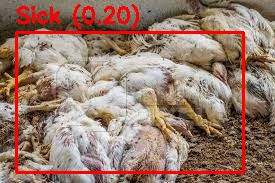

In [ ]:
import os
import cv2
import numpy as np
from collections import defaultdict
from IPython.display import display, Image, Video
from google.colab import files
from ultralytics import YOLO

# Upload media
uploaded = files.upload()
file_path = next(iter(uploaded))
is_video = file_path.lower().endswith(('.mp4', '.avi', '.mov'))

# Directories
output_dir = "/content/results"
os.makedirs(output_dir, exist_ok=True)

# Load model
model = YOLO("/content/best (3)_sayan.pt")  # Path to your YOLOv8 model
class_names = model.names
detection_confidence = 0.2

# Get unique color for each ID
def get_color(idx):
    np.random.seed(idx)
    return tuple(int(c) for c in np.random.randint(0, 255, size=3))

# IoU for ID matching
def iou(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])
    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)
    boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
    boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)
    return interArea / float(boxAArea + boxBArea - interArea + 1e-6)

# Draw trails
trails = defaultdict(list)
persistent_id_map = {}  # tracker_id -> persistent_id
last_boxes = {}         # persistent_id -> last known box
next_id = 0             # Counter for assigning new persistent IDs

# ----------- IMAGE MODE -----------
if not is_video:
    results = model(file_path, conf=detection_confidence)[0]
    im = results.orig_img.copy()

    for i, box in enumerate(results.boxes):
        conf = float(box.conf[0])
        if conf < detection_confidence:
            continue

        x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
        cls_id = int(box.cls[0])
        class_name = class_names[cls_id]

        if class_name.lower() == "sick":
            label = f"{class_name} ({conf:.2f})"
            cv2.rectangle(im, (x1, y1), (x2, y2), (0, 0, 255), 2)
            cv2.putText(im, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255), 2)

    output_img_path = os.path.join(output_dir, "sick_chickens.jpg")
    cv2.imwrite(output_img_path, im)
    display(Image(filename=output_img_path))

# ----------- VIDEO MODE -----------
else:
    cap = cv2.VideoCapture(file_path)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = cap.get(cv2.CAP_PROP_FPS)
    out_path = os.path.join(output_dir, "sick_chickens_video.mp4")
    out = cv2.VideoWriter(out_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (width, height))

    for results in model.track(source=file_path, persist=True, stream=True, conf=detection_confidence, tracker="bytetrack.yaml"):
        frame = results.orig_img.copy()
        boxes = results.boxes

        if boxes.id is not None:
            for box, tracker_id in zip(boxes, boxes.id):
                conf = float(box.conf[0])
                if conf < detection_confidence:
                    continue

                x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
                cls_id = int(box.cls[0])
                class_name = class_names[cls_id]

                if class_name.lower() != "sick":
                    continue

                tracker_id = int(tracker_id)
                current_box = (x1, y1, x2, y2)

                # Match or assign persistent ID
                matched_pid = None
                for pid, prev_box in last_boxes.items():
                    if iou(prev_box, current_box) > 0.5:
                        matched_pid = pid
                        break

                global next_id
                if matched_pid is None:
                    matched_pid = next_id
                    next_id += 1

                persistent_id_map[tracker_id] = matched_pid
                last_boxes[matched_pid] = current_box

                label = f"{class_name} - ID {matched_pid} ({conf:.2f})"
                color = get_color(matched_pid)

                cv2.rectangle(frame, (x1, y1), (x2, y2), color, 2)
                cv2.putText(frame, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

                center = (int((x1 + x2) / 2), int((y1 + y2) / 2))
                trails[matched_pid].append(center)
                if len(trails[matched_pid]) > 30:
                    trails[matched_pid].pop(0)
                for j in range(1, len(trails[matched_pid])):
                    cv2.line(frame, trails[matched_pid][j - 1], trails[matched_pid][j], color, 2)

        out.write(frame)

    cap.release()
    out.release()
    display(Video(out_path, embed=True))


Saving 1556669796267_jpg.rf.2fc789547e9b5a761a1a5d0dcdd74324.jpg to 1556669796267_jpg.rf.2fc789547e9b5a761a1a5d0dcdd74324.jpg

image 1/1 /content/1556669796267_jpg.rf.2fc789547e9b5a761a1a5d0dcdd74324.jpg: 640x640 3 Healthys, 1 Sick, 218.1ms
Speed: 10.6ms preprocess, 218.1ms inference, 1.1ms postprocess per image at shape (1, 3, 640, 640)


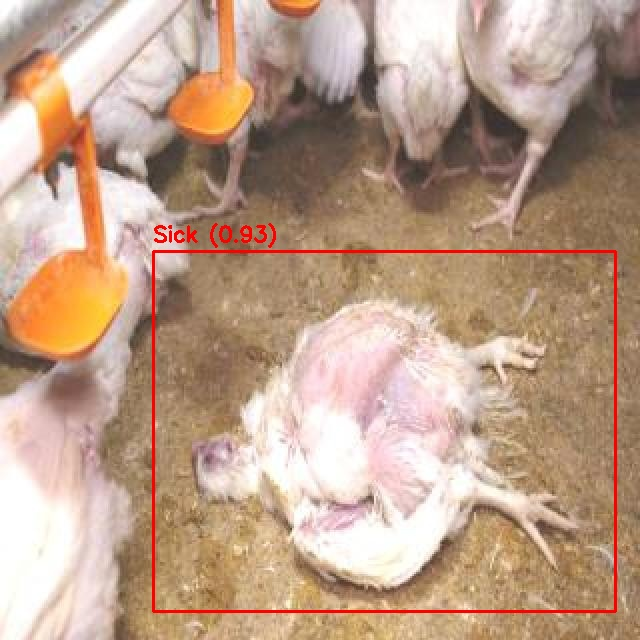

In [ ]:
import os
import cv2
import numpy as np
from collections import defaultdict
from IPython.display import display, Image, Video
from google.colab import files
from ultralytics import YOLO

# Upload media
uploaded = files.upload()
file_path = next(iter(uploaded))
is_video = file_path.lower().endswith(('.mp4', '.avi', '.mov'))

# Directories
output_dir = "/content/results"
os.makedirs(output_dir, exist_ok=True)

# Load model
model = YOLO("/content/best (3)_sayan.pt")  # Path to your YOLOv8 model
class_names = model.names
detection_confidence = 0.2

# Get unique color for each ID
def get_color(idx):
    np.random.seed(idx)
    return tuple(int(c) for c in np.random.randint(0, 255, size=3))

# IoU for ID matching
def iou(boxA, boxB):
    xA = max(boxA[0], boxB[0])
    yA = max(boxA[1], boxB[1])
    xB = min(boxA[2], boxB[2])
    yB = min(boxA[3], boxB[3])
    interArea = max(0, xB - xA + 1) * max(0, yB - yA + 1)
    boxAArea = (boxA[2] - boxA[0] + 1) * (boxA[3] - boxA[1] + 1)
    boxBArea = (boxB[2] - boxB[0] + 1) * (boxB[3] - boxB[1] + 1)
    return interArea / float(boxAArea + boxBArea - interArea + 1e-6)

# Draw trails
trails = defaultdict(list)
persistent_id_map = {}  # tracker_id -> persistent_id
last_boxes = {}         # persistent_id -> last known box
next_id = 0             # Counter for assigning new persistent IDs

# ----------- IMAGE MODE -----------
if not is_video:
    results = model(file_path, conf=detection_confidence)[0]
    im = results.orig_img.copy()

    for i, box in enumerate(results.boxes):
        conf = float(box.conf[0])
        if conf < detection_confidence:
            continue

        x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
        cls_id = int(box.cls[0])
        class_name = class_names[cls_id]

        if class_name.lower() == "sick":
            label = f"{class_name} ({conf:.2f})"
            cv2.rectangle(im, (x1, y1), (x2, y2), (0, 0, 255), 2)
            cv2.putText(im, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 0, 255), 2)

    output_img_path = os.path.join(output_dir, "sick_chickens.jpg")
    cv2.imwrite(output_img_path, im)
    display(Image(filename=output_img_path))

# ----------- VIDEO MODE -----------
else:
    cap = cv2.VideoCapture(file_path)
    width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
    height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
    fps = cap.get(cv2.CAP_PROP_FPS)
    out_path = os.path.join(output_dir, "sick_chickens_video.mp4")
    out = cv2.VideoWriter(out_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (width, height))

    for results in model.track(source=file_path, persist=True, stream=True, conf=detection_confidence, tracker="bytetrack.yaml"):
        frame = results.orig_img.copy()
        boxes = results.boxes

        if boxes.id is not None:
            for box, tracker_id in zip(boxes, boxes.id):
                conf = float(box.conf[0])
                if conf < detection_confidence:
                    continue

                x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
                cls_id = int(box.cls[0])
                class_name = class_names[cls_id]

                if class_name.lower() != "sick":
                    continue

                tracker_id = int(tracker_id)
                current_box = (x1, y1, x2, y2)

                # Match or assign persistent ID
                matched_pid = None
                for pid, prev_box in last_boxes.items():
                    if iou(prev_box, current_box) > 0.5:
                        matched_pid = pid
                        break

                global next_id
                if matched_pid is None:
                    matched_pid = next_id
                    next_id += 1

                persistent_id_map[tracker_id] = matched_pid
                last_boxes[matched_pid] = current_box

                label = f"{class_name} - ID {matched_pid} ({conf:.2f})"
                color = get_color(matched_pid)

                cv2.rectangle(frame, (x1, y1), (x2, y2), color, 2)
                cv2.putText(frame, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.5, color, 2)

                center = (int((x1 + x2) / 2), int((y1 + y2) / 2))
                trails[matched_pid].append(center)
                if len(trails[matched_pid]) > 30:
                    trails[matched_pid].pop(0)
                for j in range(1, len(trails[matched_pid])):
                    cv2.line(frame, trails[matched_pid][j - 1], trails[matched_pid][j], color, 2)

        out.write(frame)

    cap.release()
    out.release()
    display(Video(out_path, embed=True))


**SICK AND HEALTHY CHICKEN DETECTION WITH BBOX FROM VIDEO(HEALTHY TO SICK TRANSITION)**

In [4]:
import cv2
import os
from ultralytics import YOLO
from datetime import datetime

# === Setup Paths ===
input_video_path = "/content/WhatsApp Video 2025-06-08 at 8.35.20 PM.mp4"  # <-- Replace this
output_video_path = "output_sick_tracking_corrected.mp4"
model_path = "/content/best (3)_sick.pt"  # Update if needed

# === Load YOLOv8 Model ===
model = YOLO(model_path)
class_names = model.names

# === Sick Chicken Tracker Set ===
sick_tracker = set()

# === Video Processing ===
cap = cv2.VideoCapture(input_video_path)
width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))
fps = int(cap.get(cv2.CAP_PROP_FPS))
out = cv2.VideoWriter(output_video_path, cv2.VideoWriter_fourcc(*'mp4v'), fps, (width, height))

for results in model.track(source=input_video_path, persist=True, stream=True, conf=0.25, tracker="bytetrack.yaml"):
    frame = results.orig_img.copy()
    boxes = results.boxes

    if boxes.id is not None:
        for box, track_id in zip(boxes, boxes.id):
            track_id = int(track_id)
            x1, y1, x2, y2 = map(int, box.xyxy[0].tolist())
            cls_id = int(box.cls[0])
            label_name = class_names[cls_id].lower()

            # Persistently tag as SICK if ever classified that way
            if label_name == "sick" or track_id in sick_tracker:
                sick_tracker.add(track_id)
                label = f"SICK - ID {track_id}"
                color = (0, 0, 255)
            else:
                label = f"HEALTHY - ID {track_id}"
                color = (0, 255, 0)

            cv2.rectangle(frame, (x1, y1), (x2, y2), color, 2)
            cv2.putText(frame, label, (x1, y1 - 10), cv2.FONT_HERSHEY_SIMPLEX, 0.6, color, 2)

    out.write(frame)

cap.release()
out.release()

print("✅ Output saved as:", output_video_path)



video 1/1 (frame 1/804) /content/WhatsApp Video 2025-06-08 at 8.35.20 PM.mp4: 352x640 3 Healthys, 134.7ms
video 1/1 (frame 2/804) /content/WhatsApp Video 2025-06-08 at 8.35.20 PM.mp4: 352x640 3 Healthys, 124.7ms
video 1/1 (frame 3/804) /content/WhatsApp Video 2025-06-08 at 8.35.20 PM.mp4: 352x640 3 Healthys, 130.9ms
video 1/1 (frame 4/804) /content/WhatsApp Video 2025-06-08 at 8.35.20 PM.mp4: 352x640 3 Healthys, 117.3ms
video 1/1 (frame 5/804) /content/WhatsApp Video 2025-06-08 at 8.35.20 PM.mp4: 352x640 3 Healthys, 148.3ms
video 1/1 (frame 6/804) /content/WhatsApp Video 2025-06-08 at 8.35.20 PM.mp4: 352x640 3 Healthys, 118.3ms
video 1/1 (frame 7/804) /content/WhatsApp Video 2025-06-08 at 8.35.20 PM.mp4: 352x640 3 Healthys, 122.5ms
video 1/1 (frame 8/804) /content/WhatsApp Video 2025-06-08 at 8.35.20 PM.mp4: 352x640 3 Healthys, 125.1ms
video 1/1 (frame 9/804) /content/WhatsApp Video 2025-06-08 at 8.35.20 PM.mp4: 352x640 3 Healthys, 119.3ms
video 1/1 (frame 10/804) /content/WhatsApp Vi

**FOR FURTHER FINETUNING DO TRANSFER LEARNING IN THE BELOW CODE**

In [ ]:
!pip install ultralytics --upgrade -q


from ultralytics import YOLO

# Load base model (pretrained or previous fine-tuned)
model = YOLO('/content/best (3)_sick.ptt')  # Use yolov8n.pt or yolov8s.pt if dataset is small

# Training with enhanced config
model.train(
    data='/content/dataset2/data.yaml',
    epochs=50,  # train longer
    imgsz=896,  # increase input size
    batch=4,
    patience=30,
    workers=2,
    name='chicken_wide_farm_aug',
    device='cpu',

    # Optimizer and scheduler
    lr0=2e-3,
    optimizer='AdamW',  # better for dense scenes
    weight_decay=0.01,
    momentum=0.9,

    # Regularization & dropout
    dropout=0.2,

    # Aggressive Augmentations
    mosaic=1.0,
    mixup=0.5,           # higher for more blending
    copy_paste=0.2,      # enable Copy-Paste
    hsv_h=0.02,
    hsv_s=0.8,
    hsv_v=0.5,
    degrees=10,
    translate=0.2,
    scale=0.7,
    shear=3.0,
    perspective=0.001,
    flipud=0.05,
    fliplr=0.5,

    # Save checkpoints
    save_period=10
)